In [1]:
import scanpy as sc
import pandas as pd

import matplotlib.pyplot as plt

import seaborn as sns

import celltypist
from celltypist import models

from matplotlib import rcParams

import squidpy as sq
import cellcharter as cc

import numpy as np

In [2]:
# Load global object
adata = sc.read_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 646121 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [4]:
adata.obs.sample = adata.obs['sample']

In [5]:
#adata.obs.sample

## Flip xy coordinate system to match H&E slide orientation

In [6]:
# Invert y axis per sample to maintain consistent (0, max) range per sample 
for sample in adata.obs.sample.cat.categories:
    idx = adata.obs.sample == sample
    adata.obsm['spatial'][idx, 1] = np.max(adata.obsm['spatial'][idx, 1]) - adata.obsm['spatial'][idx, 1]  # invert y axis


In [7]:
adata.obsm['spatial'] = adata.obsm['spatial'][:, [1, 0]]  # flip x and y coordinates

## Exclude and adjust cell labels v1

In [8]:
#adata.obs.annot.value_counts()

In [9]:
# adata.obs.annot = adata.obs.annot.astype(str)

In [10]:
# # Recode missing values
# adata.obs.loc[adata.obs.annot == 'nan', 'annot'] = pd.NA

In [11]:
# # Merge S1 clusters
# adata.obs.loc[adata.obs.annot == 'S1_1', 'annot'] = 'S1'
# adata.obs.loc[adata.obs.annot == 'S1_2', 'annot'] = 'S1'

In [12]:
# # Exclude annotations for different specified reasons
# adata = adata[~adata.obs.annot.isin([
#     # low count annotations
#     'Mesoderm_2', 'Trm_CD4',
#     # Single sample
#     'B_naive',
#     # low quality
#     'Villus fibroblast_F3'
# ])]

In [13]:
# adata.obs.annot = adata.obs.annot.astype('category')

In [14]:
#adata.obs.annot.value_counts()

## Fix barplot of CellCharter

In [20]:
# rcParams["figure.figsize"] = (6, 6)
# sc.set_figure_params(dpi_save=450)

# sq.pl.spatial_scatter(
#     adata, 
#     color='spatial_cluster18', 
#     library_key='sample', 
#     img=None, 
#     title=adata.obs.sample.cat.categories,
#     size=8,  # point size
#     ncols=4,
#     wspace=0.5,  # inter-panel width
#     library_id=adata.obs.sample.cat.categories,
# #    save="figures_niches/CellCharter_niches18.pdf", dpi=450
# )

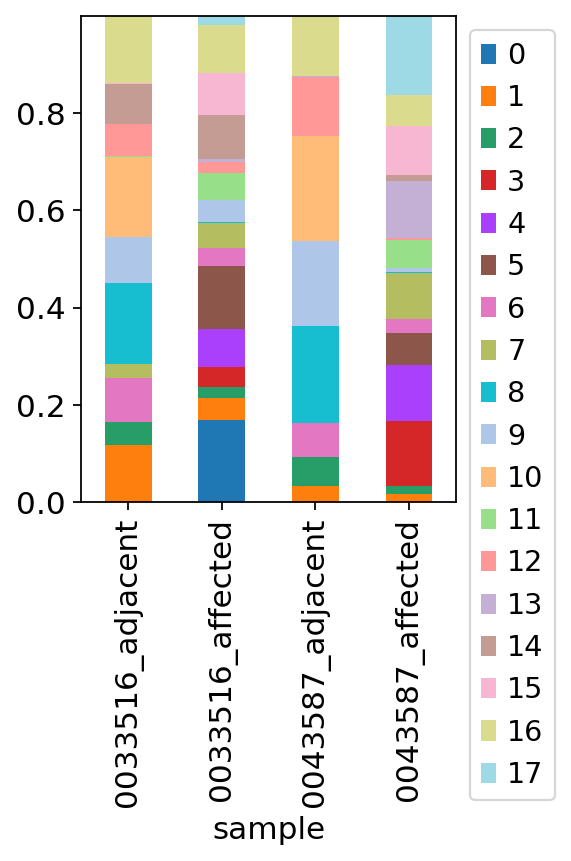

In [19]:
# Get dictionary of colors
color_dict = dict(zip(adata.obs.spatial_cluster18.cat.categories, adata.uns['spatial_cluster18_colors']))

rcParams["figure.figsize"] = (3, 4)

counts = pd.crosstab(adata.obs.spatial_cluster18, adata.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True, color=counts.index.map(color_dict))
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures_niches/barplot_xenium5k_CellCharter_niches18_v2.pdf", bbox_inches ="tight")
#plt.show()

## Cell and annotation QC (v2)

In [9]:
# Cell QC
#adata = adata[adata.obs.total_counts >= 100]
adata = adata[adata.obs.transcript_counts >= 100]

In [10]:
adata

View of AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

In [11]:
# Annotation QC for non-mesenchymal compartments
min_celltypist_confidence = 0.3
adata.obs.loc[
    ~(adata.obs.megagut_lvl1_majority_voting == "Mesenchymal") & (adata.obs.megagut_lvl3_conf_score < min_celltypist_confidence)
    , 'annot'
] = pd.NA

In [12]:
#adata = adata[adata.obs.n_genes_by_counts >=20]

In [13]:
adata

View of AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

## Annotation adjustment and exclusions (v2)

In [20]:
#adata.obs.annot.value_counts()

In [21]:
adata.obs.annot = adata.obs.annot.astype(str)

In [22]:
# Recode missing values
adata.obs.loc[adata.obs.annot == 'nan', 'annot'] = pd.NA

In [23]:
# Merge S1 clusters
adata.obs.loc[adata.obs.annot == 'S1_1', 'annot'] = 'S1'
adata.obs.loc[adata.obs.annot == 'S1_2', 'annot'] = 'S1'

In [24]:
# # Exclude annotations for different specified reasons
# adata = adata[~adata.obs.annot.isin([
#     # low count annotations
#     'Mesoderm_2', 'Trm_CD4',
#     # Single sample
#     'B_naive'
#     # Low quality prediction
#     'DC_cDC2', 'Tnaive/cm_CD4'
# ])]

In [25]:
# Set excluded predictions to NA, rather than excluding data points
adata.obs.loc[
    adata.obs.annot.isin([
    # low count annotations
    'Mesoderm_2', 'Trm_CD4',
    # Single sample
    'B_naive',
    # Low quality prediction
    'DC_cDC2', 'Tnaive/cm_CD4', 'Neuroblast', 'Villus fibroblast_F3'
]), 'annot'
] = pd.NA

In [26]:
adata.obs.annot = adata.obs.annot.astype('category')

In [27]:
adata

AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [28]:
adata.obs.annot.value_counts()

annot
B_plasma_IgA1                 33778
B_memory                      32915
Trm/em_CD8                    32747
Enterocyte                    31300
SMC_PPLP2                     29046
EC_venous                     25056
SMC_CAPN3                     18693
Macrophage                    14403
S3_crypt                      12104
Treg_IL10                     12090
Macrophage_LYVE1              10172
Trm_CD8                       10108
S3_oral_mucosa-like            9281
Glial/Enteric_neural_crest     8941
Goblet                         8867
S3_lamina propria              7471
S4                             7037
Pericyte_1                     6737
Monocyte                       6409
Pericyte_2                     6167
vSMC                           5636
S3x_1                          5522
EC_arterial_2                  5306
Myofibroblast_1                5006
TA                             4989
S1                             4785
Mast                           4606
S5                    

In [29]:
adata

AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

## Plots

In [30]:
cc.gr.enrichment(adata, group_key='spatial_cluster18', label_key='annot')

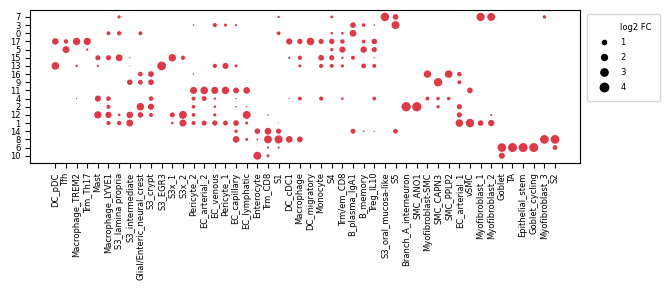

In [31]:
cc.pl.enrichment(
    adata,
    group_key='spatial_cluster18', label_key='annot',
    figsize=(6,3), fontsize=6, dot_scale=1,
    label_cluster=True,
    save="figures_niches/CellCharter_niches18_enrichment_dotplot_v4.pdf")

In [32]:
adata.obs.sample = adata.obs['sample']

In [33]:
rcParams["figure.figsize"] = (6, 6)
sc.set_figure_params(dpi_save=450)

sq.pl.spatial_scatter(
    adata, 
    color='spatial_cluster18', 
    library_key='sample', 
    img=None, 
    title=adata.obs.sample.cat.categories,
    size=8,  # point size
    ncols=4,
    wspace=0.5,  # inter-panel width
    library_id=adata.obs.sample.cat.categories,
    save="figures_niches/CellCharter_niches18_v2.pdf", dpi=450
)

# Mesenchymal subset

In [34]:
#adata.obs.annot.value_counts()

In [35]:
# Mesenchymal subset
adata_mesen = adata[adata.obs.megagut_lvl1_majority_voting == 'Mesenchymal']

In [36]:
adata_mesen.obs.megagut_lvl3_majority_voting.value_counts()

megagut_lvl3_majority_voting
SMC_PPLP2                             35520
Lamina_propria_fibroblast_ADAMDEC1    26336
Crypt_fibroblast_PI16                 21432
SMC_CAPN3                             17963
Pericyte                              11423
Oral_mucosa_fibroblast                 9777
Myofibroblast                          6659
Vascular_smooth_muscle                 6542
Fibroblast_reticular                   2957
Enterocyte                             2749
Villus_fibroblast_F3                   1218
Tnaive/cm_CD4                          1168
B_memory                                507
EC_capillary                            160
Glial/Enteric_neural_crest              150
Trm_CD4                                  67
Mesoderm_2                               21
Treg_IL10                                20
EC_lymphatic                             14
Trm_CD8                                   6
Name: count, dtype: int64

In [37]:
#adata_mesen.obs.annot.value_counts()

In [38]:
# Exclude cells that are not consistent with mesenchymal compartment according to level 3 CellTypist predictions
exclude_cells = ["Enterocyte", "Tnaive/cm_CD4", "B_memory", "Glial/Enteric_neural_crest", "Trm_CD8", "Treg_IL10", "EC_capillary", "EC_lymphatic", "Trm_CD4", "Mesoderm_2"]

adata_mesen = adata_mesen[~adata_mesen.obs.megagut_lvl3_majority_voting.isin(exclude_cells)]

#adata_mesen = adata_mesen[~adata_mesen.obs.annot.isin(["SMC_ANO1"])]

#adata_mesen = adata_mesen[~adata_mesen.obs.annot.isin(["SMC_ANO1", "Villus fibroblast_F3"])]

adata_mesen = adata_mesen[~adata_mesen.obs.annot.isin(["SMC_ANO1"])]  # exclude mixture between stromal and neural

In [39]:
# Exclude missing annotations
adata_mesen = adata_mesen[~adata_mesen.obs.annot.isna()]

In [40]:
adata_mesen

View of AnnData object with n_obs × n_vars = 136206 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', '

## Recompute UMAPs for mesenchymal subset

In [41]:
sc.pp.neighbors(adata_mesen, use_rep="X_scVI")

sc.tl.umap(adata_mesen)

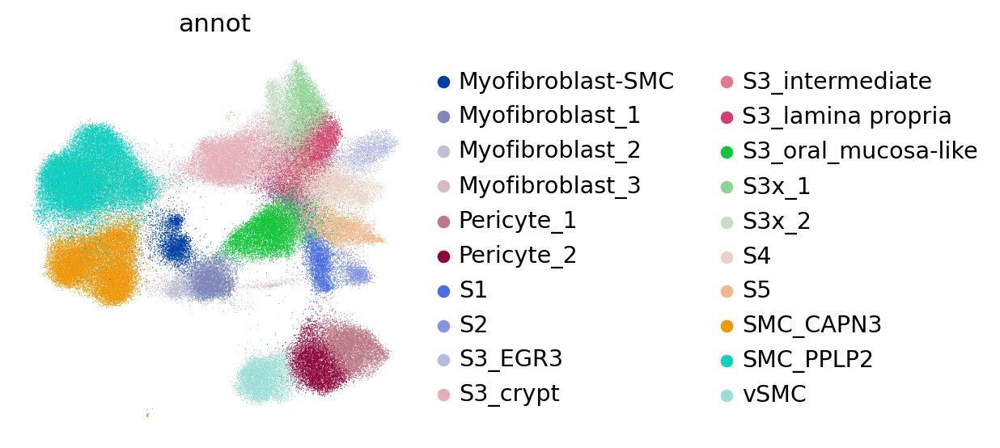

In [42]:
# Sets up color scheme for mesenehcymal subsets
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_mesen,
    color=['annot'],
    color_map="magma_r",
    wspace=0.5,
    frameon=False,
    size=1,
    #palette=sc.pl.palettes.default_102,
    palette=sc.pl.palettes.default_28,
    save="_xenium5k_mesenchymal_annot_v3.pdf"
)

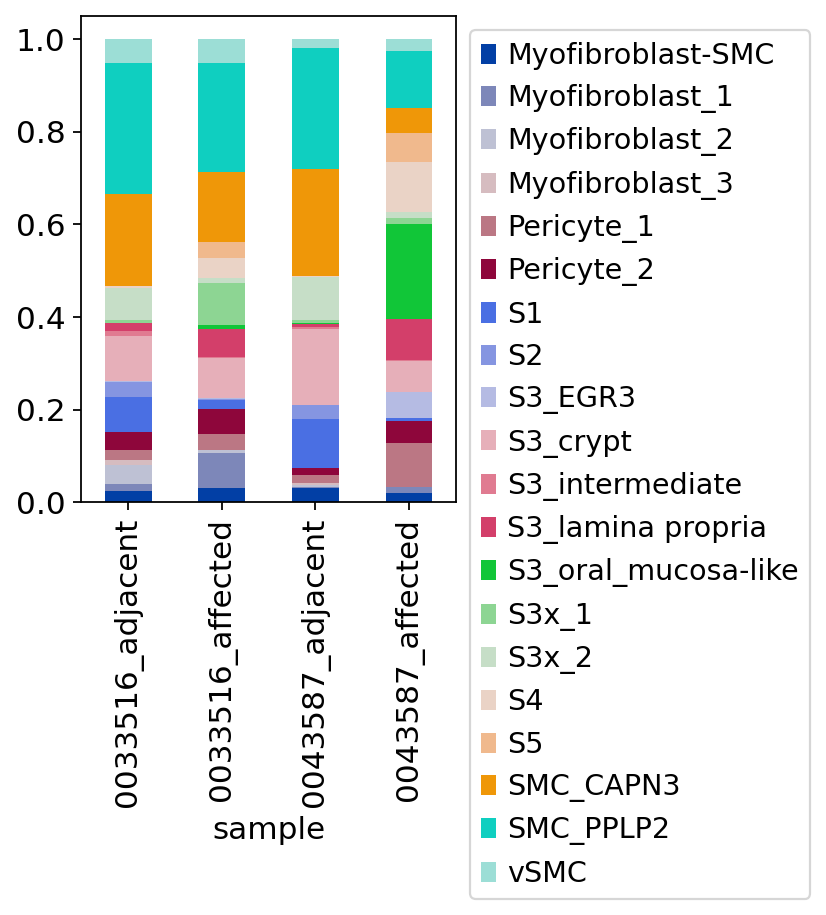

In [43]:
rcParams["figure.figsize"] = (3, 4)

# Get dictionary of colors
color_dict = dict(zip(adata_mesen.obs.annot.cat.categories, adata_mesen.uns['annot_colors']))

counts = pd.crosstab(adata_mesen.obs.annot, adata_mesen.obs['sample'], normalize='columns')
ax = counts.T.plot(kind='bar', stacked=True, color=counts.index.map(color_dict))
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.grid(False)

plt.savefig("figures_mesenchymal/barplot_xenium5k_annotation_mesenchymal_v3.pdf", bbox_inches ="tight")

In [44]:
sq.pl.spatial_scatter(
    adata_mesen, 
    color='annot', 
    library_key='sample', 
    img=None, 
    title=adata.obs.sample.cat.categories,
    size=8,  # point size
    ncols=4,
    wspace=1.5,  # inter-panel width
    library_id=adata.obs.sample.cat.categories,
    save="figures_niches/mesenchymal_annot_v3.pdf", dpi=450
)

## Villus fibroblast assessment

In [45]:
# Non-mesenchymal subset + villus fibroblasts
adata_sub = adata[~(adata.obs.megagut_lvl1_majority_voting == 'Mesenchymal') | (adata.obs.annot.isin(['S1', 'S2', 'Villus fibroblast_F3']))]

In [46]:
adata_nonmesen = adata[~(adata.obs.megagut_lvl1_majority_voting == 'Mesenchymal')]
sc.pp.subsample(adata_nonmesen, fraction=0.1)

In [47]:
adata_nonmesen

AnnData object with n_obs × n_vars = 28982 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

In [48]:
adata_sub = sc.concat([
    adata[adata.obs.annot.isin(['S1', 'S2', 'Villus fibroblast_F3'])],
    adata_nonmesen
])

In [49]:
adata_sub

AnnData object with n_obs × n_vars = 35212 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

## Make new annotation comparing specific fibroblast clusters with broad annotations

In [50]:
adata_sub.obs['annot2'] = adata_sub.obs.megagut_lvl1_majority_voting

In [51]:
adata_sub.obs.annot2 = adata_sub.obs.annot2.astype(str)

In [52]:
adata_sub.obs.annot2[adata_sub.obs.annot == 'S1'] = 'S1'
adata_sub.obs.annot2[adata_sub.obs.annot == 'S2'] = 'S2'
adata_sub.obs.annot2[adata_sub.obs.annot == 'Villus fibroblast_F3'] = 'Villus fibroblast_F3'

/tmp/ipykernel_4289/1720224572.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_sub.obs.annot2[adata_sub.obs.annot == 'S1'] = 'S1'
/tmp/ipykernel_4289/1720224572.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_sub.obs.annot2[adata_sub.obs.annot == 'S2'] = 'S2'
/tmp/ipykernel_4289/1720224572.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_sub.obs.annot2[adata_sub.obs.annot == 'Villus fibroblast_F3'] = 'Villu

In [53]:
adata_sub.obs.annot.value_counts()

annot
S1                            4785
B_plasma_IgA1                 3464
B_memory                      3300
Trm/em_CD8                    3235
Enterocyte                    2808
EC_venous                     2518
Macrophage                    1449
S2                            1445
Treg_IL10                     1233
Trm_CD8                       1027
Macrophage_LYVE1              1014
Glial/Enteric_neural_crest     907
Goblet                         849
Monocyte                       641
TA                             499
EC_arterial_2                  497
Mast                           478
Tfh                            398
Trm_Th17                       374
EC_lymphatic                   340
DC_cDC1                        242
DC_migratory                   197
EC_capillary                   150
EC_arterial_1                  137
Goblet_cycling                 109
Epithelial_stem                 81
DC_pDC                          79
Macrophage_TREM2                35
Branch_A_inter

In [54]:
#sc.pp.subsample(adata_sub, fraction=0.25)

In [55]:
adata_sub

AnnData object with n_obs × n_vars = 35212 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

In [56]:
# Recompute UMAP
sc.pp.neighbors(adata_sub, use_rep="X_scVI")

sc.tl.umap(adata_sub)

In [57]:
adata_sub

AnnData object with n_obs × n_vars = 35212 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob'

... storing 'annot2' as categorical


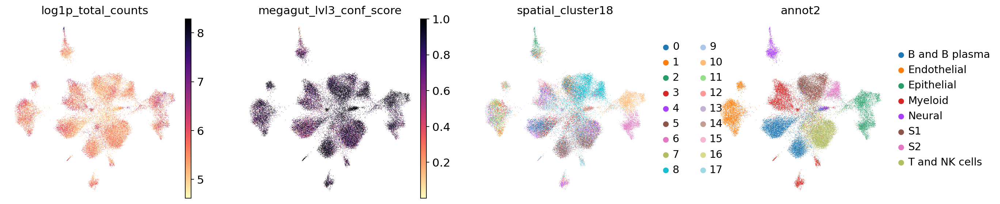

In [58]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata_sub,
    color=['log1p_total_counts', 'megagut_lvl3_conf_score', 'spatial_cluster18', 'annot2'],
    color_map="magma_r",
#    wspace=0.5,
    frameon=False,
    size=1,
#    palette=sc.pl.palettes.default_102,
    #palette=sc.pl.palettes.default_28,
    save="_xenium5k_villus_fibroblast.pdf"
)